# BechdelAI tutorial #2 - Fetching movies metadata from TMDB API

> **Objective of the tutorial**: we will learn how to use a TMDB client helper class to access movie metadata from the TMDB API. We will start by setting up the TMDB client and configuring it with our API key. Then we will explore various methods of the TMDB client that allow us to search for movies, retrieve detailed movie information, and download movie posters. Finally, we will learn how to use pandas to analyze the retrieved movie metadata and extract meaningful insights. By the end of this tutorial, you will have the skills and knowledge necessary to use the TMDB API to collect and analyze movie data. 

In [1]:
# Classical imports 
import pandas as pd

In [2]:
# For developers who want to use the latest development version or the library locally
# Use poetry to install dependencies
import sys
sys.path.append("../") # Or change to the folder to the direction of the library

%load_ext autoreload
%autoreload 2

import bechdelai

# Fetching data from TMDB

## What is TMDB ?
![](https://play-lh.googleusercontent.com/FPrLvb9BC4un9CBI6PpEmNV-4DIUxu2gIWiwkAvSU5J7uJuLvw8F5oHWHHIgFBbaOw=w240-h480-rw)

https://www.themoviedb.org/

TMDB stands for The Movie Database, which is an online database that contains information about movies, TV shows, and streaming content. It is a community-driven platform where users can contribute information such as cast and crew details, plot summaries, ratings, and reviews.

TMDB was launched in 2008 and has since become one of the most popular movie databases on the internet. It is known for its extensive collection of movie and TV show information, including details about upcoming releases and popular streaming titles.

TMDB is widely used by movie enthusiasts, content creators, and media outlets to find information about movies and TV shows. Its API (Application Programming Interface) is also used by many third-party applications and websites to display movie and TV show information.

# Connecting to TMDB API client

To use the TMDB API, you need an API key which you can obtain by creating an account on the TMDB website. 
Once you have created an account, go to your account settings and navigate to the API section to generate an API key. 

**It's essential to keep your API key private and not share it publicly**. A common approach is to store it in an environment variable file, which is not pushed to version control. For instance, create a .env file at the root of your working directory, and in this file, write the following line: API_KEY=your_api_key_here. 

*In your Jupyter notebook, you can load the environment variable file with the dotenv package if needed*

In [3]:
from bechdelai.data.tmdb import TMDB

In [4]:
# tmdb = TMDB(api_key = "XXXXXXX") #replace here with your API_KEY
# If you don't pass an API key, the TMDB class will look for one TMDB_API_KEY in an .env file
# So if you have a .env file configured, you can instantiate the TMDB client with the simple function

tmdb = TMDB()

# Fetching movie data

Let's fetch data from the last Batman movie released in 2022. https://www.themoviedb.org/movie/414906-the-batman. For that we will need the id. To get it let's use the search function. 

In [5]:
batman_movies = tmdb.search_movie_from_query("batman",n_pages = 1)

... There are 142 movies with 8 pages of results for the search 'batman'


We know have a list of Batman movies, but we want to look at the ones from 2022

In [6]:
batman_movies.head()

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
0,False,/2va32apQP97gvUxaMnL5wYt4CRB.jpg,"[14, 28, 80]",268,en,Batman,Batman must face his most ruthless nemesis whe...,53.367,/cij4dd21v2Rk2YtUQbV5kW69WB2.jpg,1989-06-23,Batman,False,7.210,6754
1,False,/bxxupqG6TBLKC60M6L8iOvbQEr6.jpg,"[28, 35, 80]",2661,en,Batman,The Dynamic Duo faces four super-villains who ...,12.935,/zzoPxWHnPa0eyfkMLgwbNvdEcVF.jpg,1966-07-30,Batman,False,6.305,711
2,False,/xEG5iP1qZCiDt4BefSpLy1d54zE.jpg,"[28, 12, 80, 878, 53, 10752]",125249,en,Batman,Japanese master spy Daka operates a covert esp...,6.957,/6XYL5JRHxaLLd0ZwsBugaAuGHTa.jpg,1943-07-16,Batman,False,6.700,39
3,False,/b0PlSFdDwbyK0cf5RxwDpaOJQvQ.jpg,"[80, 9648, 53]",414906,en,The Batman,"In his second year of fighting crime, Batman u...",259.035,/74xTEgt7R36Fpooo50r9T25onhq.jpg,2022-03-02,The Batman,False,7.700,7494
4,False,/8VSaa8ZCy43zm7aRzsyCnKOfarm.jpg,"[16, 28, 878]",886396,en,Batman and Superman: Battle of the Super Sons,"After discovering he has powers, 11-year-old J...",84.763,/mvffaexT5kA3chOnGxwBSlRoshh.jpg,2022-10-18,Batman and Superman: Battle of the Super Sons,False,7.902,174


In [7]:
batman_movies.query("original_title=='The Batman'").iloc[0]

adult                                                            False
backdrop_path                         /b0PlSFdDwbyK0cf5RxwDpaOJQvQ.jpg
genre_ids                                               [80, 9648, 53]
id                                                              414906
original_language                                                   en
original_title                                              The Batman
overview             In his second year of fighting crime, Batman u...
popularity                                                     259.035
poster_path                           /74xTEgt7R36Fpooo50r9T25onhq.jpg
release_date                                                2022-03-02
title                                                       The Batman
video                                                            False
vote_average                                                       7.7
vote_count                                                        7494
Name: 

# Exploring one movie 

In this section, we will explore how to get all metadata for a movie. Let's use the Batman movie for which we now have the idea : ``414906``

In [8]:
batman_id = 414906

We can get many details for the movie : 
- Poster url
- Movie genres
- Budget
- Language
- Synopsis
- Popularity & vote count
- Production companies
- Release year
- ...

In [10]:
details = tmdb.get_movie_details(batman_id)
details

{'adult': False,
 'backdrop_path': '/b0PlSFdDwbyK0cf5RxwDpaOJQvQ.jpg',
 'belongs_to_collection': {'id': 948485,
  'name': 'The Batman Collection',
  'poster_path': '/rTCJB5axQ8XOmGbpJBsiHkhKq14.jpg',
  'backdrop_path': '/qS2ViQwlWUECiAdkIuEaJZoq0QW.jpg'},
 'budget': 185000000,
 'genres': [{'id': 80, 'name': 'Crime'},
  {'id': 9648, 'name': 'Mystery'},
  {'id': 53, 'name': 'Thriller'}],
 'homepage': 'https://www.thebatman.com',
 'id': 414906,
 'imdb_id': 'tt1877830',
 'original_language': 'en',
 'original_title': 'The Batman',
 'overview': 'In his second year of fighting crime, Batman uncovers corruption in Gotham City that connects to his own family while facing a serial killer known as the Riddler.',
 'popularity': 259.035,
 'poster_path': '/74xTEgt7R36Fpooo50r9T25onhq.jpg',
 'production_companies': [{'id': 174,
   'logo_path': '/IuAlhI9eVC9Z8UQWOIDdWRKSEJ.png',
   'name': 'Warner Bros. Pictures',
   'origin_country': 'US'},
  {'id': 101405,
   'logo_path': None,
   'name': '6th & Ida

## Get movie poster

Let's see the movie poster, you could also use that for Computer Vision analysis. 

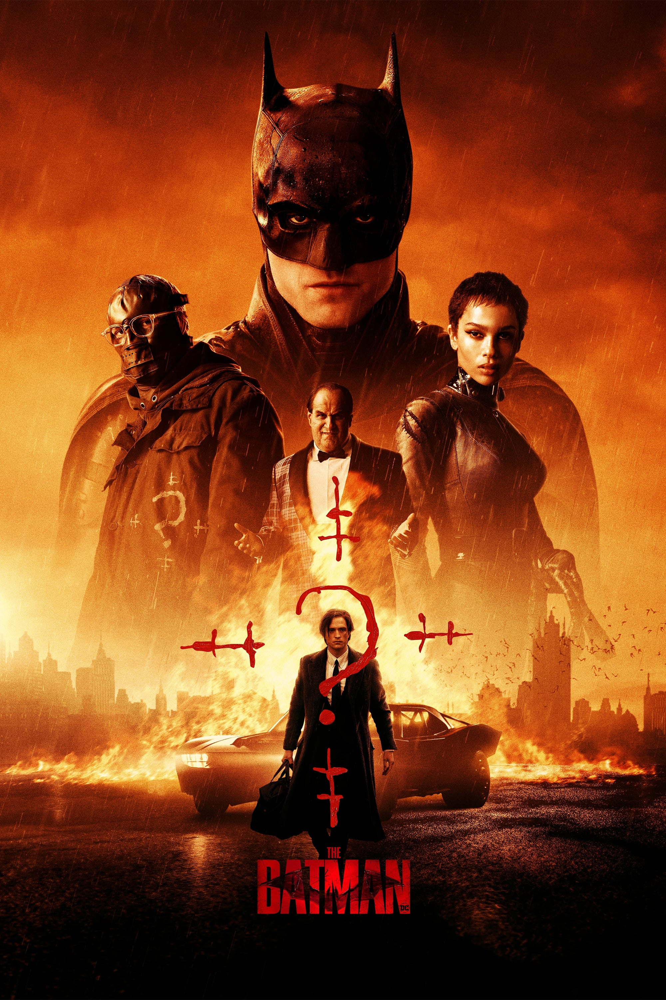

In [12]:
tmdb.get_poster_image(batman_id)

You can also get the poster from the main metadata json

/74xTEgt7R36Fpooo50r9T25onhq.jpg


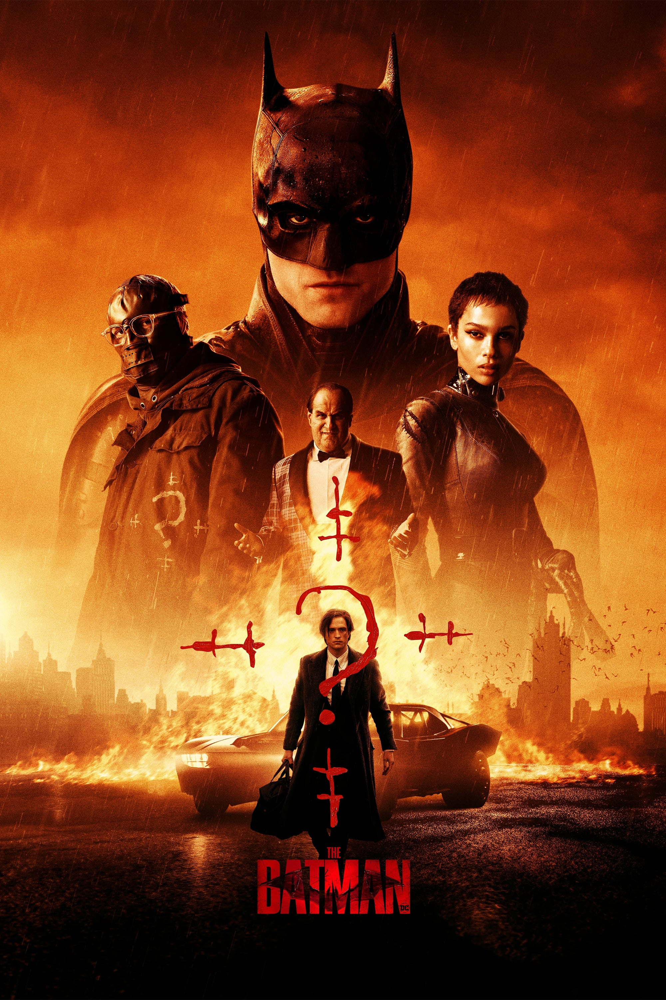

In [13]:
print(details["poster_path"])
tmdb.get_image_from_url(details["poster_path"])

## Get movie reviews

You can easily explore the reviews made by users. You could use that for characterizing the movie using NLP techniques for example. 

In [14]:
reviews = tmdb.get_movie_reviews(batman_id)
reviews.head()

... There are 21 results with 2 pages


  0%|          | 0/1 [00:00<?, ?it/s]

,author,author_details,content,created_at,id,updated_at,url
0,garethmb,"{'name': '', 'username': 'garethmb', 'avatar_p...",“The Batman” Is A Very Engaging And Unforgetta...,2022-02-28T17:12:37.932Z,621d02856b5fc2006b954bab,2022-02-28T17:12:37.932Z,https://www.themoviedb.org/review/621d02856b5f...
1,mooney240,"{'name': '', 'username': 'mooney240', 'avatar_...",The reviews and hype for this movie were massi...,2022-03-04T21:18:54.608Z,6222823ee258600046cc75b8,2022-03-05T16:47:30.168Z,https://www.themoviedb.org/review/6222823ee258...
2,MSB,"{'name': 'MSB', 'username': 'msbreviews', 'ava...",FULL SPOILER-FREE REVIEW @ https://www.msbrevi...,2022-03-04T22:48:22.045Z,6222973641aac4006c764e55,2022-03-04T22:48:22.045Z,https://www.themoviedb.org/review/6222973641aa...
3,Chris Sawin,"{'name': 'Chris Sawin', 'username': 'ChrisSawi...","Paul Dano and Colin Farrell are extraordinary,...",2022-03-06T01:50:57.237Z,62241381b84f940045446a10,2022-03-06T01:50:57.237Z,https://www.themoviedb.org/review/62241381b84f...
4,edwecks,"{'name': '', 'username': 'edwecks', 'avatar_pa...",Masterpiece. Best DC film yet,2022-03-10T15:56:26.941Z,622a1faa63aad20018c0b378,2022-03-14T16:36:48.102Z,https://www.themoviedb.org/review/622a1faa63aa...


In [15]:
print(reviews.iloc[0]["content"])

“The Batman” Is A Very Engaging And Unforgettable Tale That Is One Of The Best Adaptations Of The Character Ever

In 1989 Michael Keaton was seen as a very controversial choice to wear the Cowl of Batman but soon proved his doubters wrong by turning “Batman” and its subsequent sequel “Batman Returns” into massive Box Office success before leaving the cape behind.

While four other actors have taken up the cinematic version of the character in the subsequent years, Keaton has remained for many the Gold Standard with Christian Bale likely being his biggest rival.

When Robert Pattinson was named as the new Batman, there was interest but concern as an actor who is largely known for playing Edward in the “Twilight” films seemed to be an odd choice. However, I would say that anyone who has seen some of his recent work including his performance in “The Lighthouse” would be playing him a disservice by saying he was not up to the part.

In “The Batman”, audiences are given a darker and more br

## Get movie videos

In [16]:
videos = tmdb.get_movie_videos(batman_id)
videos.head()

,iso_639_1,iso_3166_1,name,key,site,size,type,official,published_at,id
0,en,US,Batsuit x Gadgets x Batmobile,KaisICqYXeY,YouTube,1080,Featurette,True,2022-06-14T12:59:47.000Z,62a96c1c7e12f00e260b4415
1,en,US,The Riddler Crashes the Funeral,oKrgKbX_52w,YouTube,1080,Clip,True,2022-05-31T12:59:53.000Z,62976073df86a834e2377443
2,en,US,Anatomy of the Car Chase,n9P0yd073g4,YouTube,1080,Behind the Scenes,True,2022-05-24T12:59:50.000Z,629c222503bf84009ad4b144
3,en,US,Catwoman & Batman Go Undercover,uY6y447Eye4,YouTube,1080,Clip,True,2022-05-14T20:00:08.000Z,6280e257dcf875334dca6495
4,en,US,The Batman Flies,pVow54IEcw4,YouTube,1080,Clip,True,2022-05-10T21:00:30.000Z,627b234c4b9bae00a7c8bc01


We can use that to get the trailers, which will be used later to analyze gender representation on videos

In [17]:
videos.query("type=='Trailer'")

,iso_639_1,iso_3166_1,name,key,site,size,type,official,published_at,id
10,en,US,Official HBO Max Trailer,vc7_mH2PWHs,YouTube,1080,Trailer,True,2022-04-12T21:00:54.000Z,6255e9b7cd2f0f006444d1dc
15,en,US,The Bat and The Cat Trailer,u34gHaRiBIU,YouTube,1080,Trailer,True,2021-12-27T18:00:27.000Z,61ca0378b0422800613dc85f
17,en,US,Main Trailer,mqqft2x_Aa4,YouTube,1080,Trailer,True,2021-10-16T20:36:30.000Z,616b3875e004a6005f0676c4
18,en,US,DC FanDome Teaser,NLOp_6uPccQ,YouTube,1080,Trailer,True,2020-08-23T00:57:22.000Z,5f41bf4d6a34480036b453da


You can then use the Youtube id as followed : ``https://www.youtube.com/watch?v={youtube_id}``


## Get movie keywords

TMDB indexed all movies using tags, those tags (or keywords) can be used to index or as features in a Machine Learning model

In [18]:
keywords = tmdb.get_movie_keywords(batman_id)
keywords

['crime fighter',
 'secret identity',
 'nightclub',
 'politician',
 'police',
 'psychopath',
 'vigilante',
 'superhero',
 'based on comic',
 'organized crime',
 'serial killer',
 'millionaire',
 'social injustice',
 'murder investigation',
 'aftercreditsstinger',
 'masked superhero',
 'political corruption',
 'neo-noir',
 'vengeance',
 'mayoral election']

## Get movie cast and crew

In a movie or TV show, the cast and the crew are two distinct groups of people who work together to create the final product. Here are the differences between the two:

1. **Cast**: The cast refers to the actors who appear on screen and play the characters in the story. They are the faces of the movie or TV show and are responsible for bringing the story to life through their performances. The cast is usually listed prominently in the credits and often plays a major role in promoting the project.

2. **Crew**: The crew refers to the group of people who work behind the scenes to make the movie or TV show. This includes everyone from the director and producers to the cinematographer, sound engineers, editors, and more. The crew is responsible for everything from setting up the camera shots to creating the music and sound effects to editing the final product. While the crew is not usually seen on screen, their work is critical to the success of the project.

In [19]:
cast,crew = tmdb.get_movie_cast(batman_id)
print(cast.shape)
print(crew.shape)

(82, 12)
(201, 11)


**For the cast, we get data about** : 
- Gender
- Name of the actor/actress
- Name of the character
- Popularity
- Picture
- Order in the credits

In [20]:
cast.head()

,adult,gender,id,known_for_department,name,original_name,popularity,profile_path,cast_id,character,credit_id,order
0,False,2,11288,Acting,Robert Pattinson,Robert Pattinson,40.686,/6RVxNlNmc0DIfZzaJKCJM43If3M.jpg,174,Bruce Wayne / The Batman,607213782f791500769ddac5,0
1,False,1,37153,Acting,Zoë Kravitz,Zoë Kravitz,26.319,/tiQ3TBSvU4YAyrWMmVk6MTrKBAi.jpg,60,Selina Kyle / Catwoman,5da4e941afe2240015eeec00,1
2,False,2,17142,Acting,Paul Dano,Paul Dano,35.481,/zEJJsm0z07EPNl2Pi1h67xuCmcA.jpg,68,Edward Nashton / The Riddler,5da8ae96b2681f00168df2ec,2
3,False,2,2954,Acting,Jeffrey Wright,Jeffrey Wright,19.033,/yGcuHGW4glqRpOPxgiCvjcren7F.jpg,51,Lt. James Gordon,5d89435c172d7f000d4c312d,3
4,False,2,1241,Acting,John Turturro,John Turturro,29.593,/6O9W9cJW0kCqMzYeLupV9oH0ftn.jpg,75,Carmine Falcone,5dd86320ef8b3200128c0eb9,4


**For the crew, we get data about**
- Name
- Gender
- Department
- Picture
- Job

In [21]:
crew.head()

,adult,gender,id,known_for_department,name,original_name,popularity,profile_path,credit_id,department,job
0,False,2,2122,Editing,William Hoy,William Hoy,1.755,/5UoZPWvGDKzUvJfRFavwOYM8Enz.jpg,5dbdb8bfca835400145ef0b9,Editing,Editor
1,False,2,2293,Writing,Frank Miller,Frank Miller,4.721,/2eqqLG9Sv4i1ZlM14wY2LTTEbld.jpg,6224159ed185720044379cf7,Crew,Thanks
2,False,2,3794,Writing,Bob Kane,Bob Kane,6.598,/vuXwrlqaUydA4t5SFVdQkK9KsZL.jpg,5da60dba87e63e001739c2e7,Writing,Characters
3,False,2,10949,Production,Michael Uslan,Michael Uslan,1.610,/cXiiH0SSk5UHCvHOVAhHX7tNuls.jpg,5e307a3cfd140b00136d47f2,Production,Executive Producer
4,False,1,38886,Crew,Tina Maskell,Tina Maskell,8.784,None,62c72e79c68b69004cde876f,Crew,Stunts


We will be using this endpoint to get gender information, actors metadata, as well as position in the credits. 

## Get movie images

We can get many images listed for the movie as well. There are often posters for many languages, and backdrops (images from the movie)

In [22]:
images = tmdb.get_movie_images(batman_id)
print(images.shape)
print(images["image_type"].value_counts())

(381, 8)
poster      295
backdrop     86
Name: image_type, dtype: int64


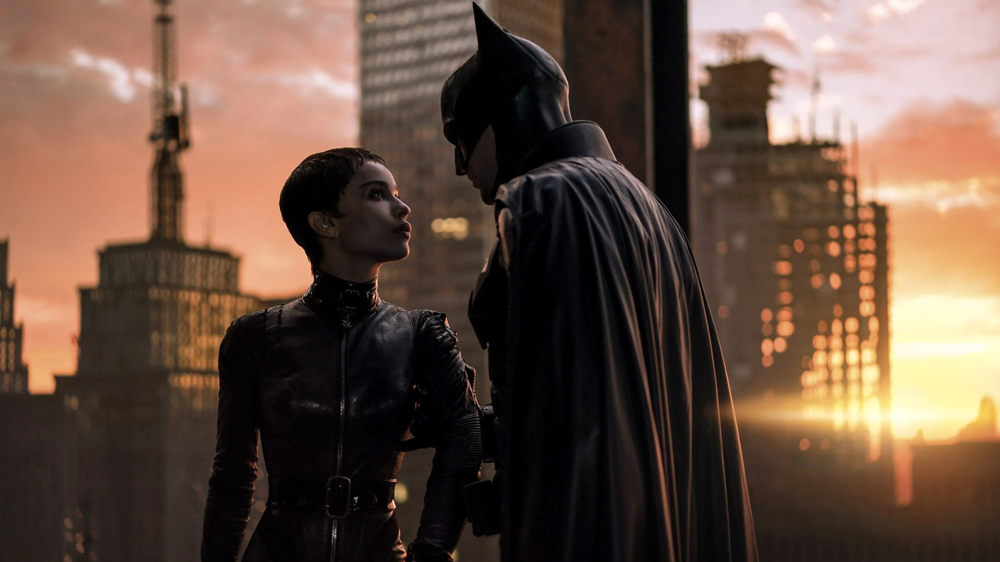

In [23]:
tmdb.get_image_from_url(images.iloc[1]["file_path"])

## Other movie metadata
You can explore the rest of the TMDB API here https://developers.themoviedb.org/3/movies if you are looking for more information. For example there are endpoints to extract similar or recommended movies if you want to build a recommender system. 

# From IMDB to TMDB

Sometimes you may get the IMDB (Internet Movie DataBase) id and not the TMDB id, if that happens you can use the following function to get the TMDB id from the IMDB id. And then use any of the previous functions to get the movie metadata. 

For example the movie *Call me by your name* has a page with the id **tt5726616** (https://www.imdb.com/title/tt5726616/)

In [24]:
imdb_id = "tt5726616"
tmdb_id = tmdb.get_id_from_imdb_id(imdb_id)
tmdb_id

398818

In [25]:
tmdb.get_movie_details(tmdb_id)

{'adult': False,
 'backdrop_path': '/zvOJawrnmgK0sL293mOXOdLvTXQ.jpg',
 'belongs_to_collection': None,
 'budget': 4000000,
 'genres': [{'id': 10749, 'name': 'Romance'}, {'id': 18, 'name': 'Drama'}],
 'homepage': 'http://sonyclassics.com/callmebyyourname/',
 'id': 398818,
 'imdb_id': 'tt5726616',
 'original_language': 'en',
 'original_title': 'Call Me by Your Name',
 'overview': "In 1980s Italy, a relationship begins between seventeen-year-old teenage Elio and the older adult man hired as his father's research assistant.",
 'popularity': 52.865,
 'poster_path': '/mZ4gBdfkhP9tvLH1DO4m4HYtiyi.jpg',
 'production_companies': [{'id': 16017,
   'logo_path': None,
   'name': 'La Cinéfacture',
   'origin_country': 'FR'},
  {'id': 30666,
   'logo_path': '/g8LmDZVFWDRJW72sj0nAj1gh8ac.png',
   'name': 'RT Features',
   'origin_country': 'BR'},
  {'id': 46344,
   'logo_path': '/uWNb5rg5RuZwcjJ7XTItXj44Gzm.png',
   'name': 'Frenesy Film',
   'origin_country': 'IT'},
  {'id': 88564,
   'logo_path': '

# Fetching multiple movies

There are multiple ways to explore the database and find several movies. You can look for a given number of ids, look for popular movies, movies currently playing at the cinema, or filtering from the database.

## Movies now playing at the cinema

You can search for movies playing at the cinema in the world or by region. Change the number of pages to get all results. 

In [26]:
tmdb.get_movies_now_playing(n_pages = 1).head()

... There are 1328 results with 67 pages


0it [00:00, ?it/s]

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
0,False,/xDMIl84Qo5Tsu62c9DGWhmPI67A.jpg,"[28, 12, 878]",505642,en,Black Panther: Wakanda Forever,"Queen Ramonda, Shuri, M’Baku, Okoye and the Do...",4429.317,/sv1xJUazXeYqALzczSZ3O6nkH75.jpg,2022-11-09,Black Panther: Wakanda Forever,False,7.5,3194
1,False,/9Rq14Eyrf7Tu1xk0Pl7VcNbNh1n.jpg,"[28, 12, 53]",646389,en,Plane,After a heroic job of successfully landing his...,3254.546,/qi9r5xBgcc9KTxlOLjssEbDgO0J.jpg,2023-01-13,Plane,False,6.7,435
2,False,/tGwO4xcBjhXC0p5qlkw37TrH6S6.jpg,"[16, 12, 35, 10751, 14]",315162,en,Puss in Boots: The Last Wish,Puss in Boots discovers that his passion for a...,2887.594,/kuf6dutpsT0vSVehic3EZIqkOBt.jpg,2022-12-07,Puss in Boots: The Last Wish,False,8.5,3755
3,False,/t72ZvOZwtvcjZivZCFtCtL8QWb0.jpg,"[28, 10749, 35]",758009,en,Shotgun Wedding,Darcy and Tom gather their families for the ul...,1866.590,/t79ozwWnwekO0ADIzsFP1E5SkvR.jpg,2022-12-28,Shotgun Wedding,False,6.3,450
4,False,/q2fY4kMXKoGv4CQf310MCxpXlRI.jpg,"[878, 27, 35]",536554,en,M3GAN,A brilliant toy company roboticist uses artifi...,1572.141,/d9nBoowhjiiYc4FBNtQkPY7c11H.jpg,2022-12-28,M3GAN,False,7.5,1612


In [27]:
tmdb.get_movies_now_playing(n_pages = 2,region = "FR").head()

... There are 141 results with 8 pages


  0%|          | 0/1 [00:00<?, ?it/s]

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
0,False,/9Rq14Eyrf7Tu1xk0Pl7VcNbNh1n.jpg,"[28, 12, 53]",646389,en,Plane,After a heroic job of successfully landing his...,3254.546,/qi9r5xBgcc9KTxlOLjssEbDgO0J.jpg,2023-01-25,Plane,False,6.7,435
1,False,/tlZBdyjh12tBJH4EW047hEigShA.jpg,"[878, 12, 35]",640146,en,Ant-Man and the Wasp: Quantumania,Super-Hero partners Scott Lang and Hope van Dy...,1349.905,/ngl2FKBlU4fhbdsrtdom9LVLBXw.jpg,2023-02-15,Ant-Man and the Wasp: Quantumania,False,6.6,223
2,False,/8oj1pbizI6RS5xlyETmlWh9mVqN.jpg,[27],955991,en,The Offering,In the wake of a young Jewish girl’s disappear...,607.956,/tbaTFgGIaTL1Uhd0SMob6Dhi5cK.jpg,2023-01-11,The Offering,False,5.8,83
3,False,/gwRMwljwHoNCyyJVgMA2XC4qPUU.jpg,"[18, 35]",615777,en,Babylon,A tale of outsized ambition and outrageous exc...,485.219,/wjOHjWCUE0YzDiEzKv8AfqHj3ir.jpg,2023-01-18,Babylon,False,7.6,1044
4,False,/cRdA9xjHBbobw4LJFsQ3j1CgpVq.jpg,[27],663712,en,Terrifier 2,"After being resurrected by a sinister entity, ...",412.135,/8gLhu8UFPZfH2Hv11JhTZkb9CVl.jpg,2023-01-11,Terrifier 2,False,7.0,1017


## Popular and top rated movies

In [28]:
tmdb.get_movies_popular(n_pages = 1,region = "FR").head()

... There are 68209 results with 3411 pages


0it [00:00, ?it/s]

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
0,False,/xDMIl84Qo5Tsu62c9DGWhmPI67A.jpg,"[28, 12, 878]",505642,en,Black Panther: Wakanda Forever,"Queen Ramonda, Shuri, M’Baku, Okoye and the Do...",4429.317,/sv1xJUazXeYqALzczSZ3O6nkH75.jpg,2022-11-09,Black Panther: Wakanda Forever,False,7.5,3194
1,False,/9Rq14Eyrf7Tu1xk0Pl7VcNbNh1n.jpg,"[28, 12, 53]",646389,en,Plane,After a heroic job of successfully landing his...,3254.546,/qi9r5xBgcc9KTxlOLjssEbDgO0J.jpg,2023-01-25,Plane,False,6.7,435
2,False,/tGwO4xcBjhXC0p5qlkw37TrH6S6.jpg,"[16, 12, 35, 10751, 14]",315162,en,Puss in Boots: The Last Wish,Puss in Boots discovers that his passion for a...,2887.594,/kuf6dutpsT0vSVehic3EZIqkOBt.jpg,2022-12-07,Puss in Boots: The Last Wish,False,8.5,3755
3,False,/t72ZvOZwtvcjZivZCFtCtL8QWb0.jpg,"[28, 10749, 35]",758009,en,Shotgun Wedding,Darcy and Tom gather their families for the ul...,1866.590,/t79ozwWnwekO0ADIzsFP1E5SkvR.jpg,2023-01-27,Shotgun Wedding,False,6.3,450
4,False,/q2fY4kMXKoGv4CQf310MCxpXlRI.jpg,"[878, 27, 35]",536554,en,M3GAN,A brilliant toy company roboticist uses artifi...,1572.141,/d9nBoowhjiiYc4FBNtQkPY7c11H.jpg,2022-12-28,M3GAN,False,7.5,1612


In [29]:
tmdb.get_movies_top_rated(n_pages = 1,region = "FR").head()

... There are 8708 results with 436 pages


0it [00:00, ?it/s]

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
0,False,/tmU7GeKVybMWFButWEGl2M4GeiP.jpg,"[18, 80]",238,en,The Godfather,"Spanning the years 1945 to 1955, a chronicle o...",87.457,/3bhkrj58Vtu7enYsRolD1fZdja1.jpg,2022-02-25,The Godfather,False,8.7,17476
1,False,/wPU78OPN4BYEgWYdXyg0phMee64.jpg,"[18, 80]",278,en,The Shawshank Redemption,Framed in the 1940s for the double murder of h...,89.930,/hBcY0fE9pfXzvVaY4GKarweriG2.jpg,1995-03-01,The Shawshank Redemption,False,8.7,23294
2,False,/wxaBkuqVIgImjRHEMJoxL9Lq6i8.jpg,"[16, 10751, 12, 14]",995133,en,"The Boy, the Mole, the Fox and the Horse","The unlikely friendship of a boy, a mole, a fo...",36.556,/oQRgyQCzcyZvE6w5heM9ktVY0LT.jpg,2022-12-26,"The Boy, the Mole, the Fox and the Horse",False,8.6,221
3,False,/kGzFbGhp99zva6oZODW5atUtnqi.jpg,"[18, 80]",240,en,The Godfather Part II,In the continuing saga of the Corleone crime f...,56.949,/hek3koDUyRQk7FIhPXsa6mT2Zc3.jpg,2022-02-23,The Godfather Part II,False,8.6,10582
4,False,/zb6fM1CX41D9rF9hdgclu0peUmy.jpg,"[18, 36, 10752]",424,en,Schindler's List,The true story of how businessman Oskar Schind...,52.566,/sF1U4EUQS8YHUYjNl3pMGNIQyr0.jpg,1994-03-02,Schindler's List,False,8.6,13765


## Discover movies

There is another endpoint to find movies from various filters, the ``discover`` endpoint https://developers.themoviedb.org/3/discover/movie-discover. 

We can use it to search for example to look for french movies released in 2021.

In [30]:
discover = tmdb.discover_movies(n_pages = 2,with_original_langue = "fr",year = 2021)
discover.head()

... There are 2318 results with 116 pages


  0%|          | 0/1 [00:00<?, ?it/s]

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
0,False,/rlNnwObbMu5G2FaOUlacnUIdIIA.jpg,"[16, 14, 28, 10770]",726684,fr,"Miraculous World: Shanghai, la légende de Lady...","On school break, Marinette heads to Shanghai t...",82.216,/qQ0VKsGRQ2ofAmswGNzZnvC1xPE.jpg,2021-05-15,Miraculous World: Shanghai – The Legend of Lad...,False,7.9,509
1,False,/zEddiBK6yZNUGVnmBJzmnYcEWiR.jpg,"[18, 53, 27]",630240,fr,Titane,A woman with a metal plate in her head from a ...,62.036,/wY7jeCdbhWuYao4WHI51pc51a9b.jpg,2021-07-14,Titane,False,6.5,1054
2,False,/mDvx0cafHm1Z0R295wMxzpVTGf9.jpg,"[16, 12, 14, 35, 10751]",676705,fr,Pil,"Pil, a little vagabond girl, lives on the stre...",49.524,/abPQVYyNfVuGoFUfGVhlNecu0QG.jpg,2021-08-11,Pil's Adventures,False,6.8,139
3,False,/rUoGZuscSG4fQP3I56ndadu2A8E.jpg,"[28, 35]",729720,fr,Le Dernier Mercenaire,A legendary secret service agent comes out of ...,41.082,/ttpKJ7XQxDZV252KNEHXtykYT41.jpg,2021-07-30,The Last Mercenary,False,6.6,538
4,False,/vkIJ2QgcKMJRvi6pBW4Tr2kgLdy.jpg,"[53, 28, 80]",637534,fr,BAC Nord,A police brigade working in the dangerous nort...,30.374,/nLanxl7Xhfbd5s8FxPy8jWZw4rv.jpg,2021-08-18,The Stronghold,False,7.4,984


# Downloading all posters from a list of ids

Let's say you want to analyze gender representation on all posters using Computer Vision from a list of movies. This section is here to help. You started by getting the 10 top rated movies from TMDB. 

In [31]:
top_rated = tmdb.get_movies_top_rated(n_pages = 10).query("vote_count > 10000").head(10)
top_rated

... There are 10809 results with 541 pages


  0%|          | 0/9 [00:00<?, ?it/s]

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,title,video,vote_average,vote_count
1,False,/tmU7GeKVybMWFButWEGl2M4GeiP.jpg,"[18, 80]",238,en,The Godfather,"Spanning the years 1945 to 1955, a chronicle o...",87.457,/3bhkrj58Vtu7enYsRolD1fZdja1.jpg,1972-03-14,The Godfather,False,8.7,17476
2,False,/wPU78OPN4BYEgWYdXyg0phMee64.jpg,"[18, 80]",278,en,The Shawshank Redemption,Framed in the 1940s for the double murder of h...,89.930,/hBcY0fE9pfXzvVaY4GKarweriG2.jpg,1994-09-23,The Shawshank Redemption,False,8.7,23294
4,False,/kGzFbGhp99zva6oZODW5atUtnqi.jpg,"[18, 80]",240,en,The Godfather Part II,In the continuing saga of the Corleone crime f...,56.949,/hek3koDUyRQk7FIhPXsa6mT2Zc3.jpg,1974-12-20,The Godfather Part II,False,8.6,10582
5,False,/zb6fM1CX41D9rF9hdgclu0peUmy.jpg,"[18, 36, 10752]",424,en,Schindler's List,The true story of how businessman Oskar Schind...,52.566,/sF1U4EUQS8YHUYjNl3pMGNIQyr0.jpg,1993-12-15,Schindler's List,False,8.6,13765
7,False,/Ab8mkHmkYADjU7wQiOkia9BzGvS.jpg,"[16, 10751, 14]",129,ja,千と千尋の神隠し,"A young girl, Chihiro, becomes trapped in a st...",73.180,/39wmItIWsg5sZMyRUHLkWBcuVCM.jpg,2002-09-20,Spirited Away,False,8.5,13957
10,False,/hiKmpZMGZsrkA3cdce8a7Dpos1j.jpg,"[35, 53, 18]",496243,ko,기생충,"All unemployed, Ki-taek's family takes peculia...",59.467,/7IiTTgloJzvGI1TAYymCfbfl3vT.jpg,2019-05-30,Parasite,False,8.5,15259
11,False,/l6hQWH9eDksNJNiXWYRkWqikOdu.jpg,"[14, 18, 80]",497,en,The Green Mile,A supernatural tale set on death row in a Sout...,86.948,/velWPhVMQeQKcxggNEU8YmIo52R.jpg,1999-12-10,The Green Mile,False,8.5,15053
12,False,/pbEkjhdfP7yuDcMB78YEZwgD4IN.jpg,"[18, 28, 80, 53]",155,en,The Dark Knight,Batman raises the stakes in his war on crime. ...,86.443,/qJ2tW6WMUDux911r6m7haRef0WH.jpg,2008-07-14,The Dark Knight,False,8.5,29194
13,False,/suaEOtk1N1sgg2MTM7oZd2cfVp3.jpg,"[53, 80]",680,en,Pulp Fiction,"A burger-loving hit man, his philosophical par...",62.375,/d5iIlFn5s0ImszYzBPb8JPIfbXD.jpg,1994-09-10,Pulp Fiction,False,8.5,24671
16,False,/3h1JZGDhZ8nzxdgvkxha0qBqi05.jpg,"[35, 18, 10749]",13,en,Forrest Gump,A man with a low IQ has accomplished great thi...,64.050,/arw2vcBveWOVZr6pxd9XTd1TdQa.jpg,1994-06-23,Forrest Gump,False,8.5,24162


In [32]:
all_ids = top_rated["id"].tolist()
all_ids

[238, 278, 240, 424, 129, 496243, 497, 155, 680, 13]

In [33]:
tmdb.download_all_posters(all_ids,"posters_top_rated")

  0%|          | 0/10 [00:00<?, ?it/s]

## Fetching all data from a list of movies

Now let's get all metadata, cast and crew data for this list of movies

In [34]:
metadata,cast,crew = tmdb.get_all_movies_details(all_ids,is_imdb_id = False)

  0%|          | 0/10 [00:00<?, ?it/s]

In [35]:
metadata.head()

,adult,backdrop_path,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
0,False,/tmU7GeKVybMWFButWEGl2M4GeiP.jpg,"{'id': 230, 'name': 'The Godfather Collection'...",6000000,"[{'id': 18, 'name': 'Drama'}, {'id': 80, 'name...",http://www.thegodfather.com/,238,tt0068646,en,The Godfather,...,1972-03-14,245066411,175,"[{'english_name': 'English', 'iso_639_1': 'en'...",Released,An offer you can't refuse.,The Godfather,False,8.715,17479
1,False,/wPU78OPN4BYEgWYdXyg0phMee64.jpg,None,25000000,"[{'id': 18, 'name': 'Drama'}, {'id': 80, 'name...",,278,tt0111161,en,The Shawshank Redemption,...,1994-09-23,28341469,142,"[{'english_name': 'English', 'iso_639_1': 'en'...",Released,Fear can hold you prisoner. Hope can set you f...,The Shawshank Redemption,False,8.702,23297
2,False,/kGzFbGhp99zva6oZODW5atUtnqi.jpg,"{'id': 230, 'name': 'The Godfather Collection'...",13000000,"[{'id': 18, 'name': 'Drama'}, {'id': 80, 'name...",,240,tt0071562,en,The Godfather Part II,...,1974-12-20,102600000,202,"[{'english_name': 'English', 'iso_639_1': 'en'...",Released,"I don't feel I have to wipe everybody out, Tom...",The Godfather Part II,False,8.599,10582
3,False,/zb6fM1CX41D9rF9hdgclu0peUmy.jpg,None,22000000,"[{'id': 18, 'name': 'Drama'}, {'id': 36, 'name...",http://www.schindlerslist.com/,424,tt0108052,en,Schindler's List,...,1993-12-15,321365567,195,"[{'english_name': 'German', 'iso_639_1': 'de',...",Released,"Whoever saves one life, saves the world entire.",Schindler's List,False,8.567,13767
4,False,/Ab8mkHmkYADjU7wQiOkia9BzGvS.jpg,None,19000000,"[{'id': 16, 'name': 'Animation'}, {'id': 10751...",http://movies.disney.com/spirited-away,129,tt0245429,ja,千と千尋の神隠し,...,2002-09-20,274925095,125,"[{'english_name': 'Japanese', 'iso_639_1': 'ja...",Released,,Spirited Away,False,8.540,13958


# Fetching person data

In this section you will learn how to get data from an actor or an actress. Let's find everything about Robert Pattinson. 

In [36]:
cast,crew = tmdb.get_movie_cast(batman_id)
cast.head()

,adult,gender,id,known_for_department,name,original_name,popularity,profile_path,cast_id,character,credit_id,order
0,False,2,11288,Acting,Robert Pattinson,Robert Pattinson,40.686,/6RVxNlNmc0DIfZzaJKCJM43If3M.jpg,174,Bruce Wayne / The Batman,607213782f791500769ddac5,0
1,False,1,37153,Acting,Zoë Kravitz,Zoë Kravitz,26.319,/tiQ3TBSvU4YAyrWMmVk6MTrKBAi.jpg,60,Selina Kyle / Catwoman,5da4e941afe2240015eeec00,1
2,False,2,17142,Acting,Paul Dano,Paul Dano,35.481,/zEJJsm0z07EPNl2Pi1h67xuCmcA.jpg,68,Edward Nashton / The Riddler,5da8ae96b2681f00168df2ec,2
3,False,2,2954,Acting,Jeffrey Wright,Jeffrey Wright,19.033,/yGcuHGW4glqRpOPxgiCvjcren7F.jpg,51,Lt. James Gordon,5d89435c172d7f000d4c312d,3
4,False,2,1241,Acting,John Turturro,John Turturro,29.593,/6O9W9cJW0kCqMzYeLupV9oH0ftn.jpg,75,Carmine Falcone,5dd86320ef8b3200128c0eb9,4


In [37]:
robert_id = 11288

In [38]:
tmdb.get_person_details(robert_id)

{'adult': False,
 'also_known_as': ['R-Pattz',
  'Rob',
  'ロバート・パティンソン',
  'Роберт Паттинсон',
  '로버트 패틴슨',
  'Ρόμπερτ Πάτινσον',
  'Роберт Паттінсон',
  '罗伯特·帕丁森'],
 'biography': "Robert Douglas Thomas Pattinson (born 13 May 1986) is an English actor. Noted for his versatile roles in both big-budget and independent films, Pattinson has been ranked among the world's highest-paid actors. After starting to act in a London theatre club at age 15, Pattinson began his film career by playing Cedric Diggory in the fantasy film Harry Potter and the Goblet of Fire (2005). He gained worldwide recognition for portraying Edward Cullen in The Twilight Saga film series (2008–2012), which grossed over $3.3 billion worldwide. After starring in the romantic dramas Remember Me (2010) and Water for Elephants (2011), Pattinson received critical acclaim for his performances in independent films from auteur directors. He starred in David Cronenberg's thriller Cosmopolis (2012), David Michôd's dystopian west

You can also find all movies and TV shows in which Robert Pattinson played

In [39]:
pd.DataFrame(tmdb.get_person_credits(robert_id)["cast"])

,adult,backdrop_path,genre_ids,id,original_language,original_title,overview,popularity,poster_path,release_date,...,vote_count,character,credit_id,order,media_type,origin_country,original_name,first_air_date,name,episode_count
0,False,/mUZfZf8Doaxka3hsQDOqDUUWL0g.jpg,"[18, 53, 27, 10770]",21505,en,The Haunted Airman,"An injured RAF pilot, confined to a wheelchair...",4.593,/71PbHyrUdowV9HhW7fixWAPwH2l.jpg,2006-10-31,...,24,Toby Jugg,52fe441cc3a368484e0100cd,0.0,movie,NaN,NaN,NaN,NaN,NaN
1,False,/dmdfIman0PmPpFPJJJYQvPjlVyP.jpg,"[18, 10749]",23169,en,Remember Me,Still reeling from a heartbreaking family even...,24.650,/j7umuMiLCHvWT7wYhFKJOTFSokF.jpg,2010-04-07,...,3257,Tyler Hawkins,52fe4461c3a368484e01fb51,0.0,movie,NaN,NaN,NaN,NaN,NaN
2,False,None,"[10749, 18]",48798,en,Love and Distrust,This collection of five short films artfully p...,4.310,/7uuVzCB04DAncrN51A5VYnJvpFC.jpg,2010-08-16,...,26,Richard (Segment 1: The Summer House),52fe4775c3a36847f8136d69,0.0,movie,NaN,NaN,NaN,NaN,NaN
3,False,/8Hztp05inY15obLOWpmveWOBKFy.jpg,[18],49014,en,Cosmopolis,Riding across Manhattan in a stretch limo duri...,10.532,/vZEUKrNspiOmy4Muiy7ne6TOVPq.jpg,2012-05-25,...,1096,Eric Packer,52fe4780c3a36847f8139387,0.0,movie,NaN,NaN,NaN,NaN,NaN
4,False,/gNoiP5BZJF4uYtyG5bT1rBDdc4W.jpg,"[35, 18]",19713,en,How to Be,A young man having an existential crisis convi...,2.177,/eiO4L0uKMWiRxexY6MQ1yeHRWjo.jpg,2008-01-17,...,35,Art,52fe47eb9251416c750a9dc1,0.0,movie,NaN,NaN,NaN,NaN,NaN
5,False,/12xU204ABgr31iCTM57JT6wGFMg.jpg,"[18, 10749]",55787,en,Water for Elephants,"In this captivating Depression-era melodrama, ...",11.762,/8T7Hvb9trKvCAmbSI8cEIU0Sl2T.jpg,2011-04-15,...,2319,Jacob Jankowski,52fe48e0c3a36847f817e3bf,0.0,movie,NaN,NaN,NaN,NaN,NaN
6,False,/xBZZl8hWlDAdqSphTYb7zmWzVdU.jpg,"[10749, 18]",86467,en,Bel Ami,"Georges Duroy travels through 1890s Paris, fro...",8.402,/59bgVtpX6MPy2d5zberJiRNkDDx.jpg,2012-03-09,...,459,Georges Duroy,52fe49879251416c910b040d,0.0,movie,NaN,NaN,NaN,NaN,NaN
7,False,/xq41fcgtkJgorfMPNseNY9lZ25i.jpg,[18],300153,en,Life,"In 1955, young photographer Dennis Stock devel...",8.216,/aT6joQI1aOHDFvQst7gFJkIhN6N.jpg,2015-07-24,...,318,Dennis Stock,54532132c3a36814800007ad,0.0,movie,NaN,NaN,NaN,NaN,NaN
8,False,/qkl57wzSFrpi2sRpoc2mZJbMuLP.jpg,"[12, 14, 18, 10749]",50620,en,The Twilight Saga: Breaking Dawn - Part 2,"After the birth of Renesmee, the Cullens gathe...",73.094,/7IGdPaKujv0BjI0Zd0m0a4CzEjJ.jpg,2012-11-13,...,8088,Edward Cullen,52fe47cfc3a36847f8149623,0.0,movie,NaN,NaN,NaN,NaN,NaN
9,False,/bo5VJbds3oeMoj19GFnzBoUgjJS.jpg,"[878, 18, 9648]",376865,en,High Life,A father and his daughter struggle to survive ...,14.693,/ftRRIYNzpTDYeTznrAxgT5v1vJY.jpg,2018-09-26,...,926,Monte,5692530b92514115ce001de1,0.0,movie,NaN,NaN,NaN,NaN,NaN


We can also get all images from Robert Pattinson. Which can be used to fuel a face detection algorithm.

In [40]:
pd.DataFrame(tmdb.get_person_images(robert_id)["profiles"])

,aspect_ratio,height,iso_639_1,file_path,vote_average,vote_count,width
0,0.667,3000,None,/6RVxNlNmc0DIfZzaJKCJM43If3M.jpg,5.852,90,2000
1,0.667,2777,None,/8A4PS5iG7GWEAVFftyqMZKl3qcr.jpg,5.644,64,1851
2,0.667,1323,None,/duIMemPKSwv2XLDmQBUUWGxOE3y.jpg,5.606,30,882
3,0.667,699,None,/2Ib4WouZY5pCLkSRpDO8JXZ0mF9.jpg,5.430,66,466
4,0.667,2963,None,/3qZ09UE7lN6AtorfXFRYpEtSY93.jpg,5.386,102,1975
5,0.667,1518,None,/9CbfQHyUhJZxWjlVqsdS3I4j9t5.jpg,5.330,40,1012
6,0.667,3000,None,/cAyQSJFdVn7VdGXK9X7R5K8wMm5.jpg,5.166,44,2000
7,0.667,957,None,/vk9D76LgHd1c8ZZPBBC4DAi1D6q.jpg,5.036,74,638
8,0.667,1551,None,/cptSJJ2WEAPxiYAFWkNctHzYit.jpg,5.024,70,1034
9,0.667,1200,None,/ewjMaXKnh5r95iFs97MwbykEU1Z.jpg,5.024,70,800
